<a href="https://colab.research.google.com/github/mckuoling/EEG-Datasets/blob/master/Fuzzy_Semantic_Target_Identification_in_Natural_Reading_Environments.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Opendata source and citation:

Yanru Bai and Qi Tang and Ran Zhao and Hongxing Liu and Mingkun Guo and Shuming Zhang and Minghan Guo and Junjie Wang and Changjian Wang and Mu Xing and Guangjian Ni and Dong Ming (2024). TMNRED, A Chinese Language EEG Dataset for Fuzzy Semantic Target Identification in Natural Reading Environments. OpenNeuro. [Dataset] doi: doi:10.18112/openneuro.ds005383.v1.0.0

https://openneuro.org/datasets/ds005383/versions/1.0.0/file-display/README

Paper: https://www.nature.com/articles/s41597-025-05036-2

Data Preposessing: https://neuraldatascience.io/7-eeg/introduction.html

MNE workflow: https://mne.tools/stable/documentation/cookbook.html

#Set up the environment

In [1]:
!pip install mne
import mne

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 49.1 MB/s eta 0:00:00


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Load the data

In [3]:
# Path to your BrainVision files - modified for Colab
eeg_data01 = mne.io.read_raw_eeglab('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1/sub-01-ses-1.set', preload=True)
eeg_data01.info

#Lowpass 100.00HZ → 資料在記錄時已進行過 100 Hz 的低通濾波




Reading /content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1/sub-01-ses-1.fdt


<ipython-input-3-68abae331e05>:2: RuntimeWarning: Data file name in EEG.data (1108-1.fdt) is incorrect, the file name must have changed on disk, using the correct file name (sub-01-ses-1.fdt).
  eeg_data01 = mne.io.read_raw_eeglab('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1/sub-01-ses-1.set', preload=True)


Reading 0 ... 24894  =      0.000 ...   124.470 secs...


<ipython-input-3-68abae331e05>:2: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  eeg_data01 = mne.io.read_raw_eeglab('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1/sub-01-ses-1.set', preload=True)
<ipython-input-3-68abae331e05>:2: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  eeg_data01 = mne.io.read_raw_eeglab('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1/sub-01-ses-1.set', preload=True)


<Info | 8 non-empty values
 bads: []
 ch_names: Fp1, Fp2, Fz, F3, F4, F7, F8, FC1, FC2, FC5, FC6, Cz, C3, C4, ...
 chs: 30 EEG
 custom_ref_applied: False
 dig: 33 items (3 Cardinal, 30 EEG)
 highpass: 0.0 Hz
 lowpass: 100.0 Hz
 meas_date: unspecified
 nchan: 30
 projs: []
 sfreq: 200.0 Hz
>

Using matplotlib as 2D backend.


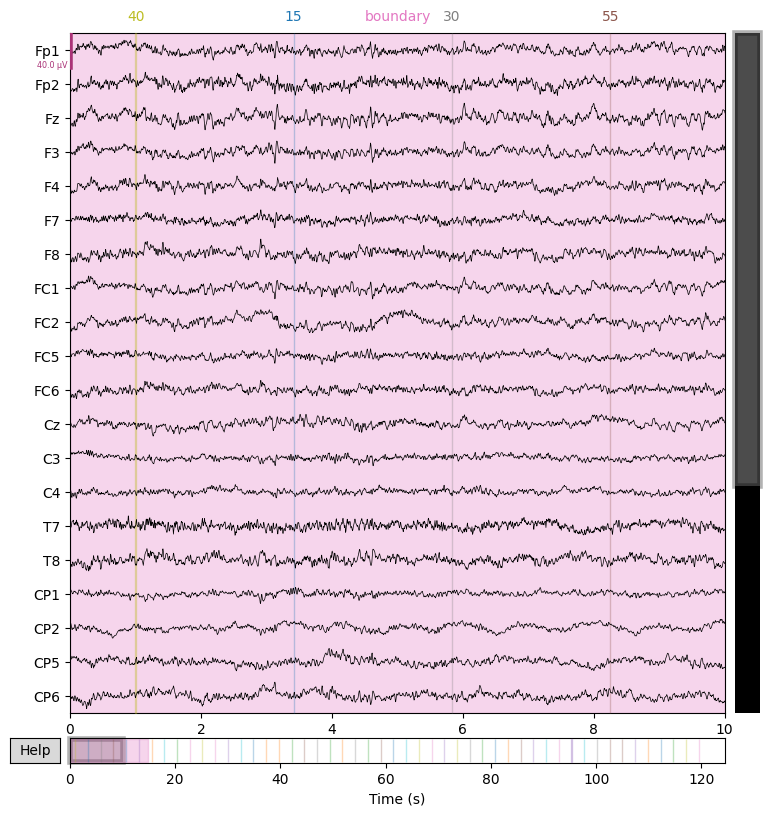

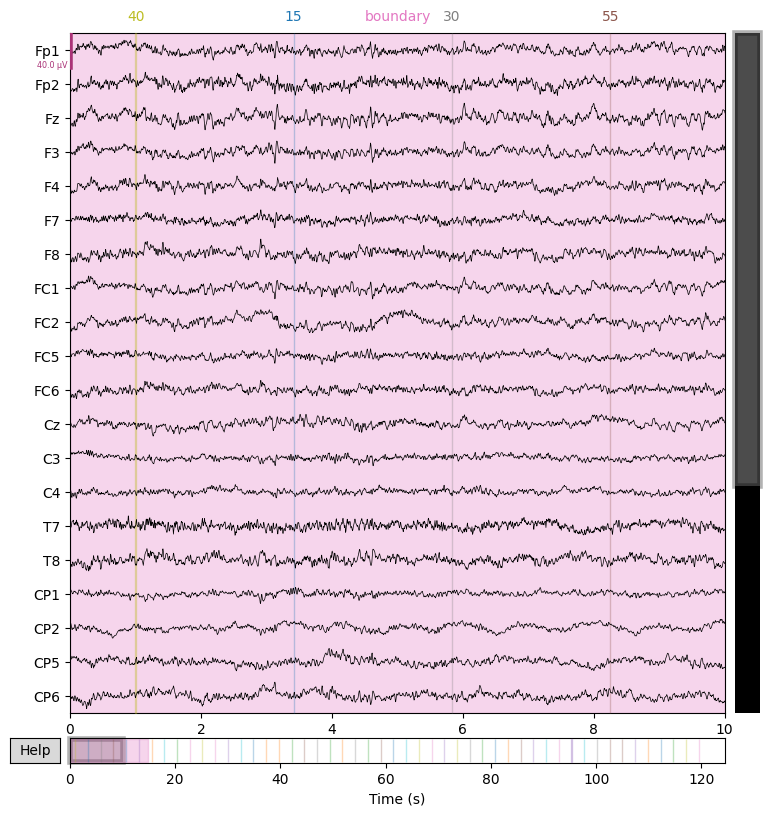

In [4]:
eeg_data01.plot()

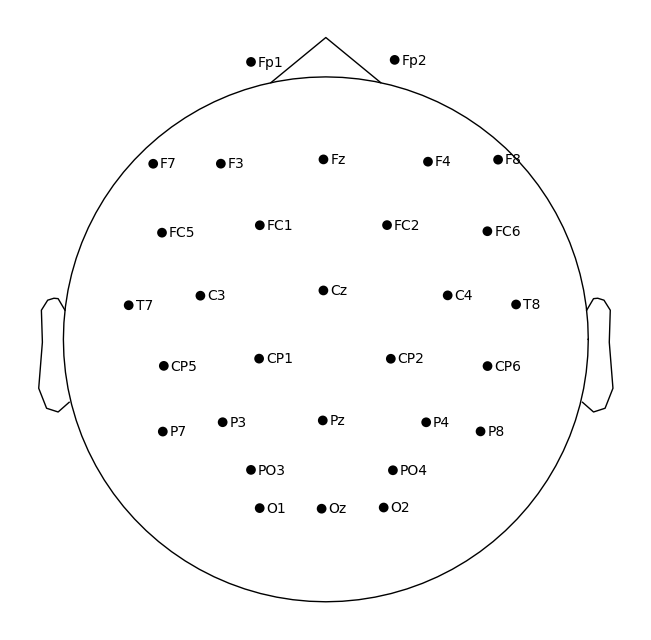

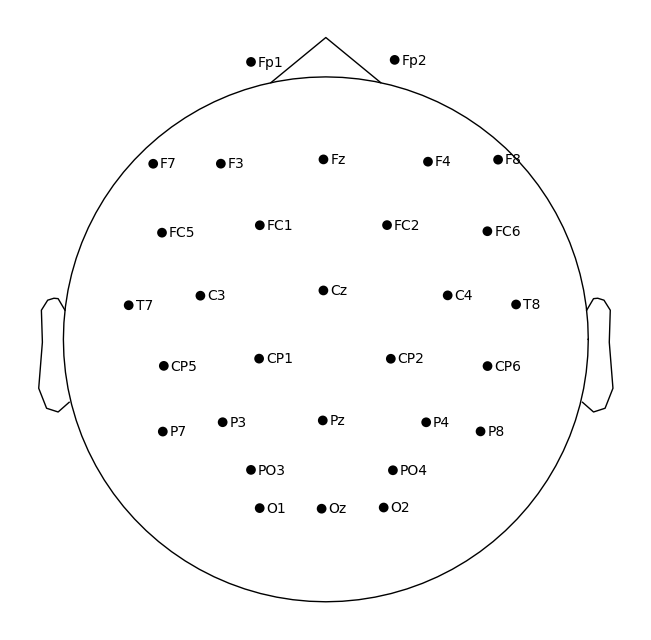

In [5]:
montage = mne.channels.make_standard_montage('standard_1020') #This line is added to define the montage
eeg_data01.set_montage(montage, on_missing='warn') #允許某些電極缺少的話只顯示警告而不報錯
eeg_data01.plot_sensors(ch_type='eeg', show_names=True)

In [6]:
print(eeg_data01.info['ch_names'])


['Fp1', 'Fp2', 'Fz', 'F3', 'F4', 'F7', 'F8', 'FC1', 'FC2', 'FC5', 'FC6', 'Cz', 'C3', 'C4', 'T7', 'T8', 'CP1', 'CP2', 'CP5', 'CP6', 'Pz', 'P3', 'P4', 'P7', 'P8', 'PO3', 'PO4', 'Oz', 'O1', 'O2']


NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 10.240 (s)
Plotting power spectral density (dB=True).


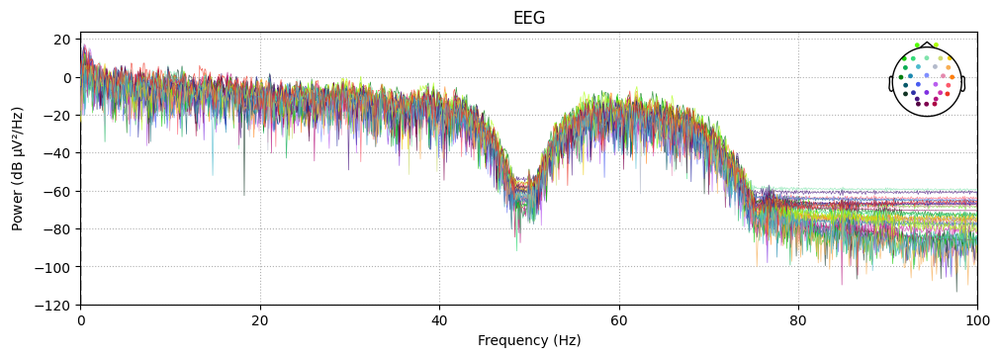

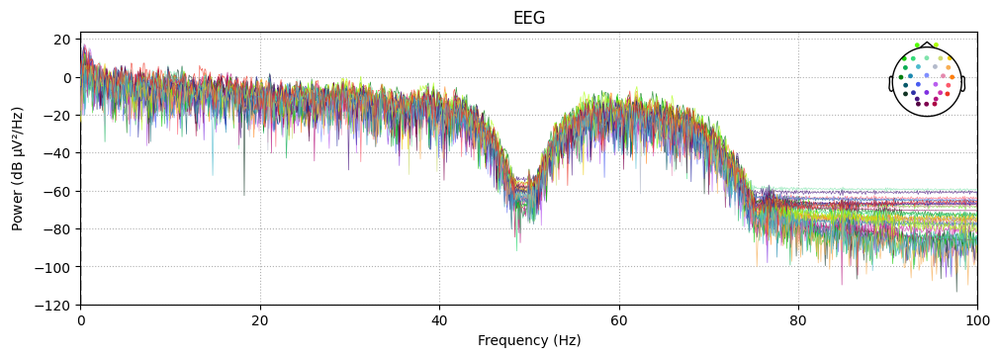

In [7]:
eeg_data01_cropped = eeg_data01.copy()
eeg_data01_cropped = eeg_data01_cropped.crop(tmax=20)
eeg_data01_cropped.times[-1]
eeg_data01_cropped.plot_psd(picks=['eeg'])

#功率（power）: 指的是正弦波的振幅 amplitude of sine waves when we are working in the frequency domain
#頻譜（spectrum）:一個頻率範圍 a range of frequencies,
#密度（density）:正在量化在這段頻率範圍內的功率 we’re quantifying the power over a range of frequencies
#1/f property: power is highest at the lowest frequencies, and drops off with increasing frequency. The dropoff is not linear (a diagonal line), but rather decreases at approximately 1 divided by the frequency.

#Filter the EEG data

In [8]:
low_cut = 0.1
hi_cut  = 30

eeg_data01_filt = eeg_data01.copy().filter(low_cut, hi_cut)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 6601 samples (33.005 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.1s finished


Effective window size : 10.240 (s)
Plotting power spectral density (dB=True).


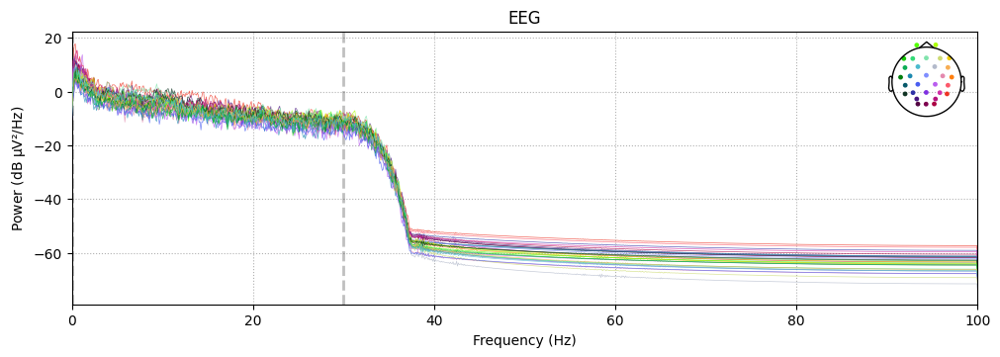

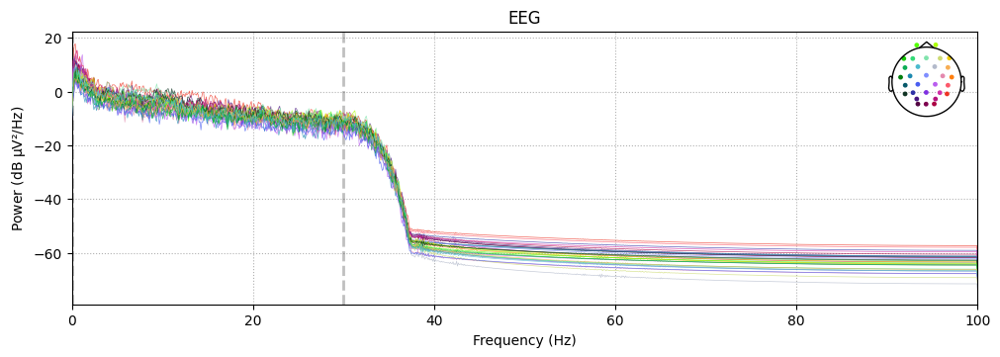

In [9]:
eeg_data01_filt.compute_psd().plot()
#eeg_data01_filt.compute_psd(fmax=5).plot() zoom in

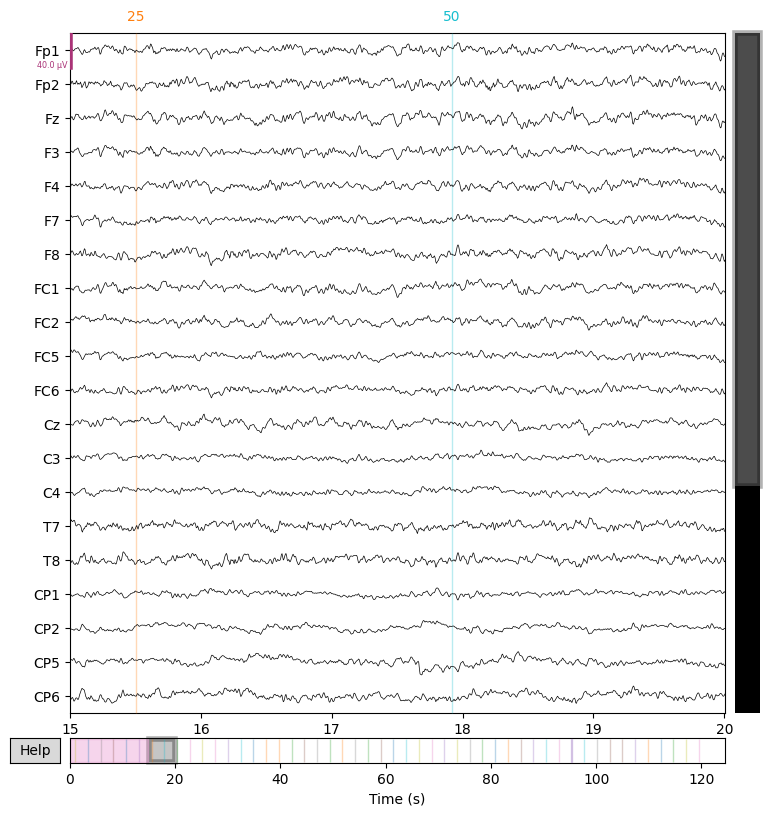

In [10]:
eeg_data01.plot(start=15, duration=5);  # 原始還沒filter過的data

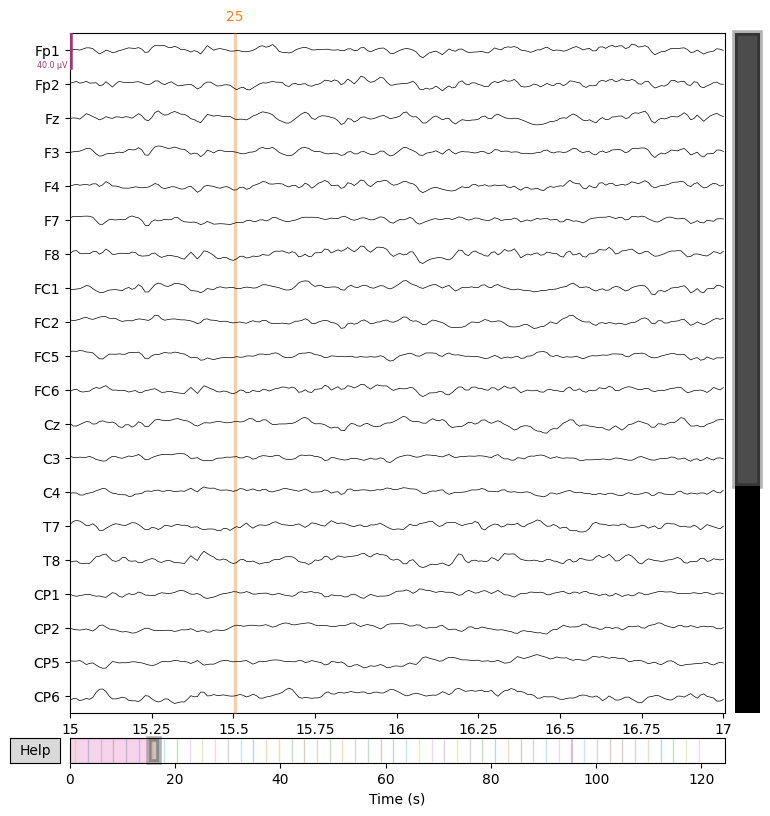

In [11]:
eeg_data01_filt.plot(start=15, duration=2);  # filter過的data

In [12]:
#把filter過和沒filter過的各自儲存
eeg_data01.save('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1' + 'eeg_data01' + '-raw.fif',
         overwrite=True)
eeg_data01_filt.save('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1' + 'eeg_data01' + '-filt-raw.fif',
              overwrite=True)

Overwriting existing file.
Writing /content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1eeg_data01-raw.fif
Closing /content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1eeg_data01-raw.fif
[done]
Overwriting existing file.
Writing /content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1eeg_data01-filt-raw.fif
Closing /content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1eeg_data01-filt-raw.fif
[done]


[PosixPath('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/ses-1eeg_data01-filt-raw.fif')]

#Remove the artifacts

In [13]:
import mne
import os
mne.set_log_level('error')  # reduce extraneous MNE output

# Participant ID code
p_id = 'sub-01'
data_dir = f'/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/{p_id}'
raw_fname_artifact = 'ses-1eeg_data01-raw.fif'
# Read the Raw Data
raw_path_artifact = os.path.join(data_dir, raw_fname_artifact)
raw_artifact = mne.io.read_raw_fif(raw_path_artifact, preload=True)
raw_artifact.set_montage('easycap-M1')




<Raw | ses-1eeg_data01-raw.fif, 30 x 24895 (124.5 s), ~5.7 MiB, data loaded>

## Filter data for ICA

**What's ICA?**

ICA 是一種能將複雜訊號分離成「彼此獨立的成分」的數學演算法。
能把腦電訊號與各種雜訊分離開，因為不同來源的訊號在時間與空間（電極位置）上具有不同特性。

ICA works best on data that has more low-frequency power removed than the data that we ultimately want to analyze. So we will filter the data for ICA with a 1 Hz high-pass cutoff, rather than the 0.1 Hz cutoff as we used in the filtering lesson (which is a more typical cutoff for ERP data).

In [14]:
# Filter settings
ica_low_cut = 1.0 # For ICA, we filter out more low-frequency power
hi_cut  = 30

raw_artifact_ica = raw_artifact.copy().filter(ica_low_cut, hi_cut)

## Segment data for ICA

ICA works best with segments of data, rather than the continuous raw data. We call segments of EEG data epochs, a word which means “a period of time.”

(Different from the "epoch" that refers to the segments of data that are time-locked to experimental events of interest)

In [15]:
# Break raw data into 1 s epochs
tstep = 1.0
events_ica = mne.make_fixed_length_events(raw_artifact_ica, duration=tstep)
epochs_ica = mne.Epochs(raw_artifact_ica, events_ica,
                        tmin=0.0, tmax=tstep,
                        baseline=None,
                        preload=True)

## Preclean data for ICA

`AutoReject` is an automated and data-driven way of determining a threshold to distinguish between “noisy” and “clean” channels and epochs in the data.

To run AutoReject, we first import the function and then create an AutoReject object, which we call `ar`. Recall that objects are essentially specialized Python data structures that store information in specifically-named fields. We then run the fit method of the object on the epochs_ica data. This will compute the threshold for each channel and epoch, and store it in the `ar` object. We save the list of rejected epochs and channels to `reject_log`.

In [16]:
!pip install autoreject
from autoreject import AutoReject

ar = AutoReject(n_interpolate=[1, 2, 4],
                random_state=42,
                picks=mne.pick_types(epochs_ica.info,
                          eeg=True,
                          eog=False
                                    ),
                n_jobs=-1,
                verbose=False
                )

ar.fit(epochs_ica)

reject_log = ar.get_reject_log(epochs_ica)


AutoReject provides a `.plot()` method for visualizing the results of the fit.

*   y axis is the channels
*   x axis is epochs
*   Green areas are “good” data
*   Red vertical lines indicate epochs that were marked as “bad”
*   The blue lines indicate that specific channels that were marked as “bad” on epochs where most of the channels were considered “good”



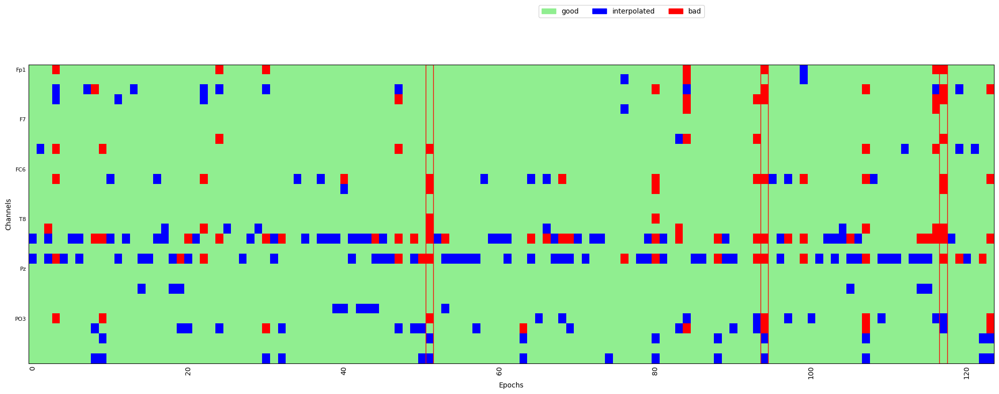

In [17]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=[20, 8])
reject_log.plot('horizontal', ax=ax, aspect='auto')
plt.show()

## Fit ICA to the Data

Running ICA on our data involves two steps, similar to AutoReject:

1.  Create an ICA object with the parameters (passed as kwargs) that we want to use. (→ 建立一個 ICA 物件，並設定分析時要使用的參數（以關鍵字參數形式傳入）
2.  fit this object to the data — which effectively runs the algorithm on the data, using the parameters set in step 1.(→ 將這個 ICA 物件套用到資料上（呼叫 .`fit()`），這樣演算法就會依照上一步設定的參數執行)

建立 ICA 物件的好處是，我們會擁有一個「和原始 EEG 資料分開」的資料結構，用來儲存 ICA 前處理的重要資訊。一旦我們用 `.fit()` 把 ICA 物件套用到資料上，這個 ICA 物件就會儲存「從資料中估計出來的成分資訊」。換句話說，`.fit()` 不會改變原始 EEG 資料，只是更新 ICA 物件的內容。如果我們不滿意分析結果，不需要重新讀取 EEG 資料，只要改 ICA 的參數再` .fit()` 一次就好。

In [18]:
# ICA parameters
random_state = 42   # ensures ICA is reproducible each time it's run
ica_n_components = .99  # Specify n_components as a decimal to set % explained variance

# Fit ICA
ica = mne.preprocessing.ICA(n_components=ica_n_components,
                  random_state=random_state,
                            )
ica.fit(epochs_ica[~reject_log.bad_epochs], decim=3)

Method,fastica
Fit parameters,algorithm=parallelfun=logcoshfun_args=Nonemax_iter=1000
Fit,124 iterations on epochs (8107 samples)
ICA components,21
Available PCA components,30
Channel types,eeg
ICA components marked for exclusion,—


## Visualize ICA components

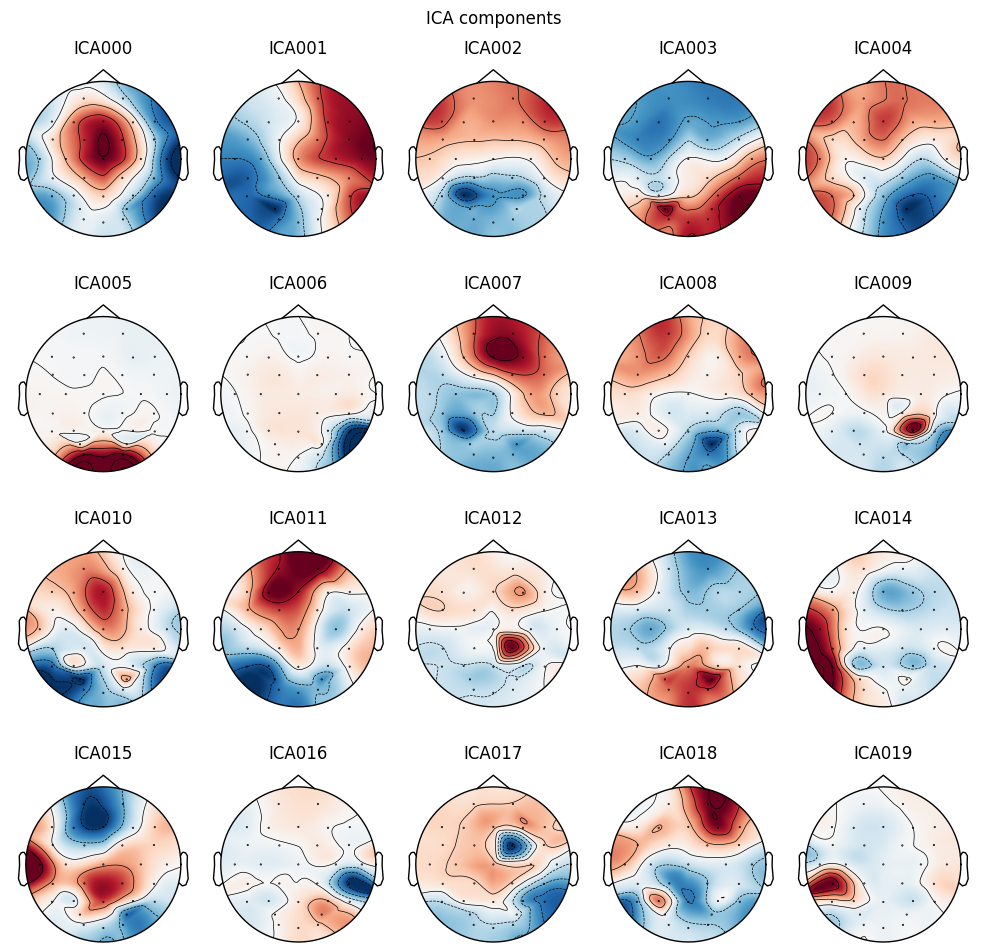

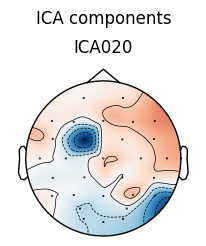

In [19]:
ica.plot_components();

**Use `.plot_properties()` method of the ICA class to view more details of each IC.**

*  The topo map：顯示這個成分在各個電極上的權重（類似熱圖），能看出訊號來自頭部的哪個區域。若是眨眼成分，通常集中在眼睛上方的電極。若是水平眼動，通常左右前額電極呈現相反極性（紅藍對稱）。

*   Raster plot: 顯示該 IC 在每一個試次的活動強度，橫軸為時間、縱軸為不同試次（epochs）。眨眼 artifact 會呈現少數試次出現的「橫條狀閃現（streaks）」，持續約 200–300 毫秒。Components reflecting brain activity are typically present across many epochs (although remember that these data are segmented into 1 s epochs across the entire raw data set, so we would not expect to see time-locked activity here)

*  Variance of the component, across channels and time. 變異程度圖：顯示該 IC 在各試次、各通道間的變異程度。

  x-axis：epochs

  y-axis：the variance of the IC across channels
  
  雜訊成分通常會在少數epoch呈現高變異，其餘試次為低變異。真實腦電活動會在各epoch中出現一致、變異較低的分佈。

*  The PSD (phase spectral density) of the IC: 頻譜圖：顯示該成分在不同頻率上的能量強度。
  
  眼動（EOG）artifact：能量集中在低頻（頻譜左側）
  
  肌肉雜訊：能量在高頻端增加（頻譜右側）

/usr/local/lib/python3.11/dist-packages/mne/viz/ica.py:181: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=figsize, facecolor=[0.95] * 3)


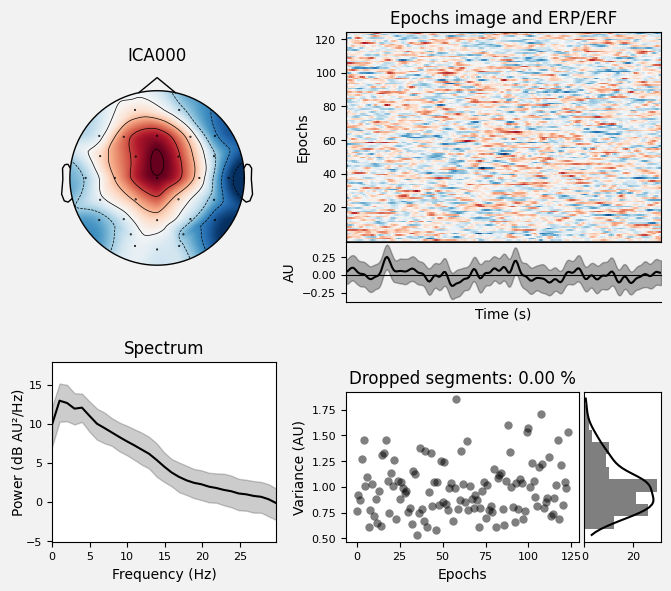

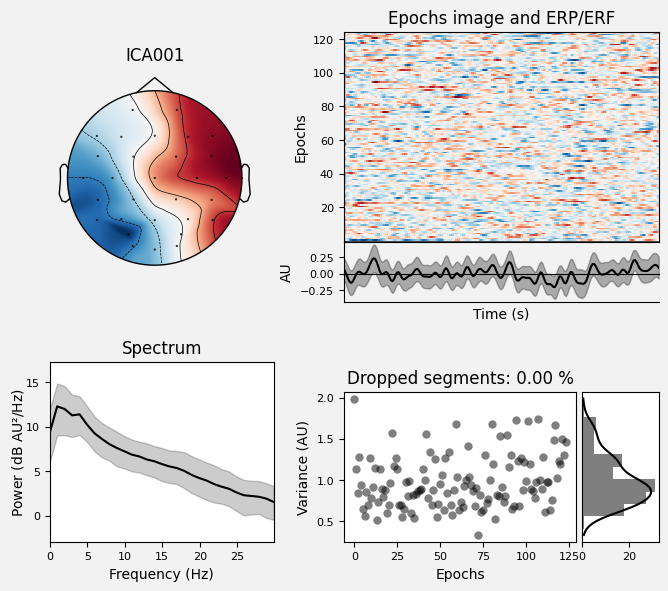

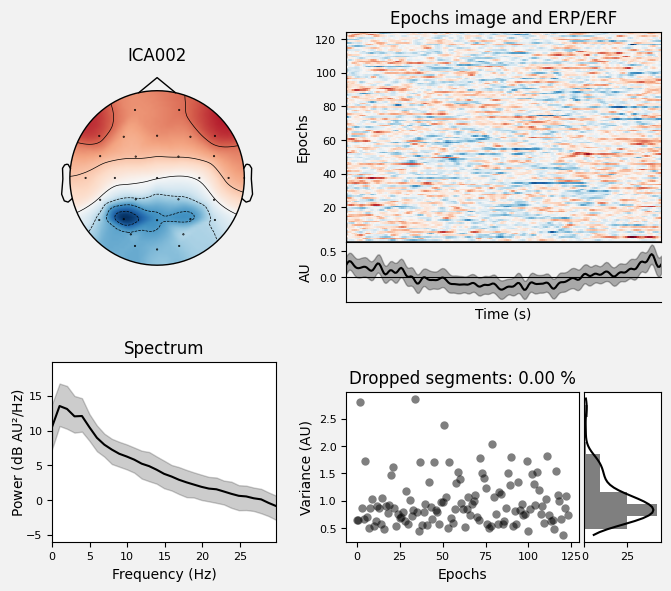

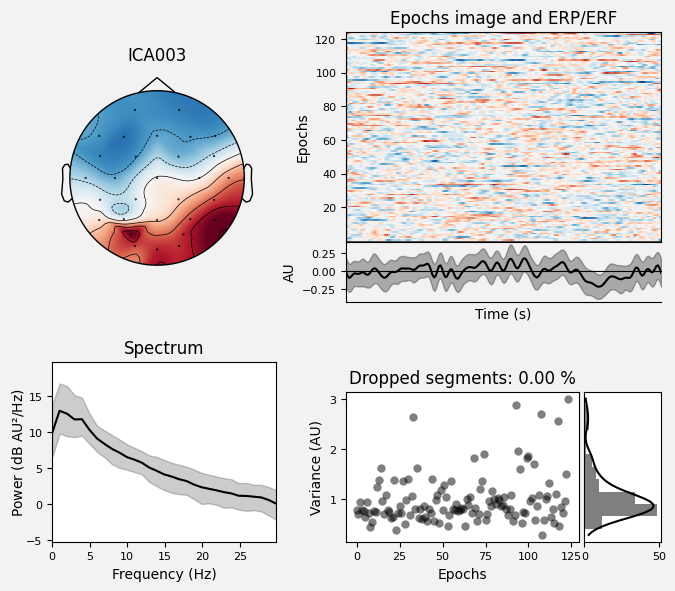

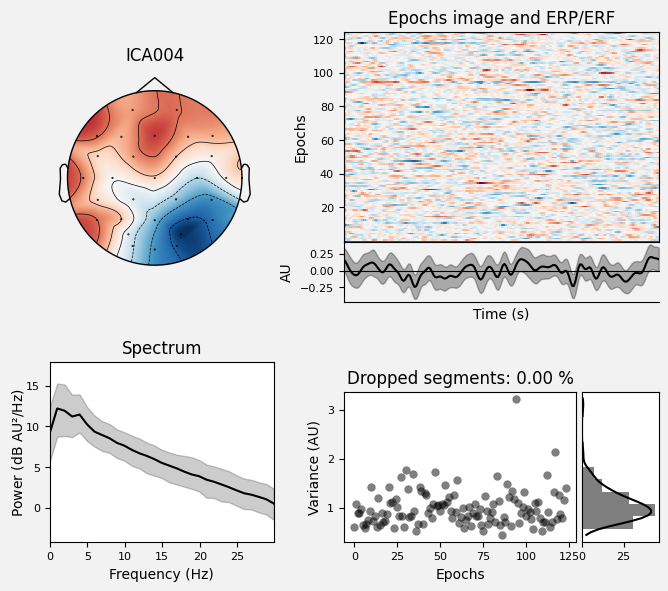

...

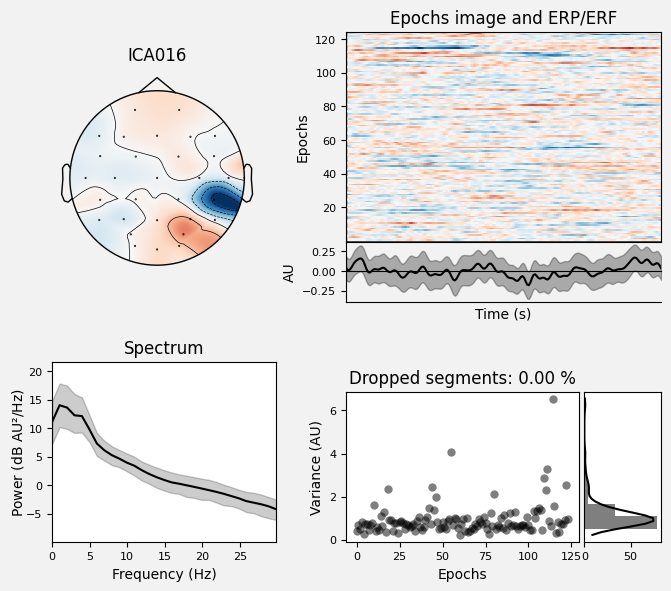

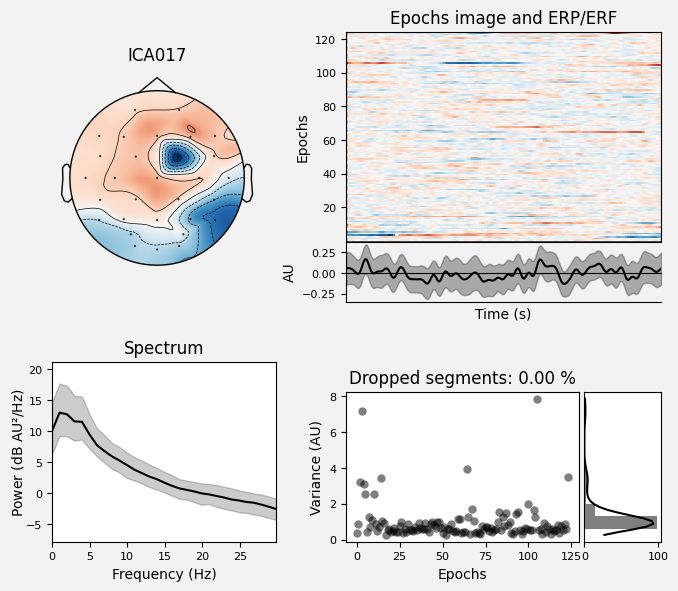

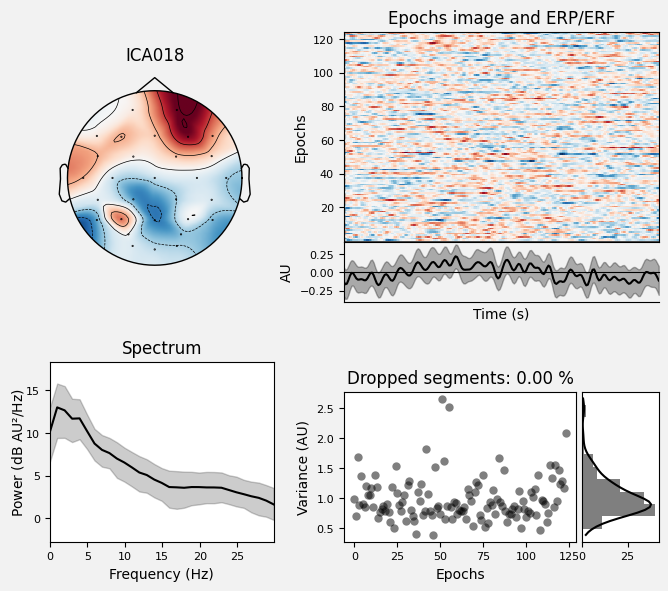

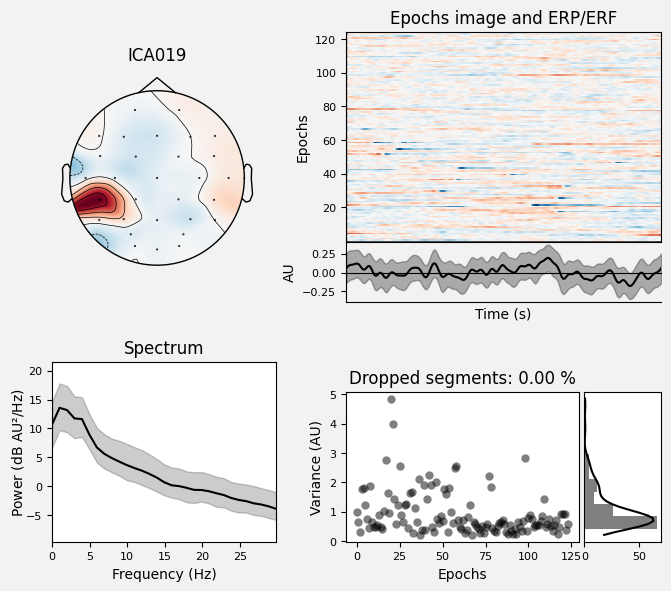

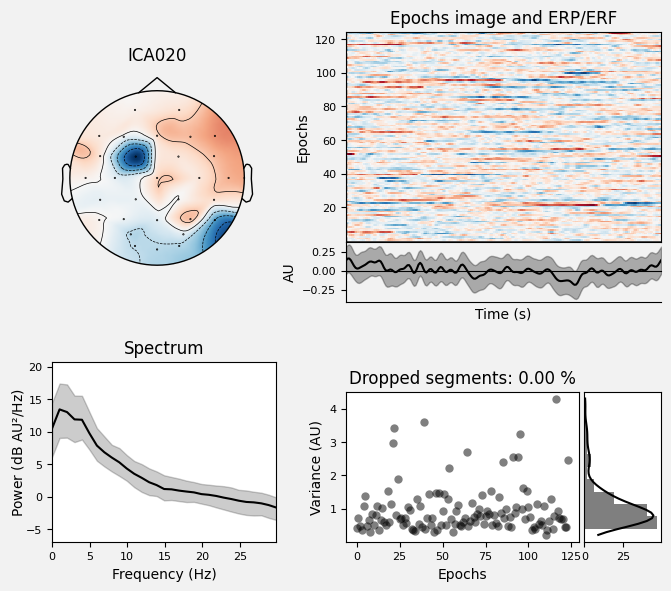

In [20]:
ica.plot_properties(epochs_ica, picks=range(0, ica.n_components_), psd_args={'fmax': hi_cut});

## Identify EOG Artifacts from ICA Components

MNE has an algorithm that attempts to automatically identify ICA components.

`find_bads_eog()` 會計算每個 ICA 成分與 EOG（眼電圖）通道的相關係數，藉此判斷該成分是否為眼動造成的雜訊。

我們可以透過 `ch_name `參數，手動指定哪些 EEG 電極作為「EOG 通道」。

`threshold`：設定相關係數的門檻值，超過這個值的 ICA 成分會被判定為 EOG 雜訊。預設門檻是 3.0，但實際上不同資料的最佳門檻會有很大差異。

所以可以用一個 `while` 迴圈，從 3.5 開始，每次減 0.1，直到至少找出兩個 ICA 成分（因為預期會有一個眨眼和一個水平眼動的成分）。

最後挑出的兩個 ICA，應該就是與眼睛附近電極相關性最高的兩個成分。

In [21]:
ica.exclude = []
num_excl = 0
max_ic = 2
z_thresh = 3.5
z_step = .05

while num_excl < max_ic:
    eog_indices, eog_scores = ica.find_bads_eog(epochs_ica,
                            ch_name=['Fp1', 'Fp2'],
                            threshold=z_thresh
                                                )
    num_excl = len(eog_indices)
    z_thresh -= z_step # won't impact things if num_excl is ≥ n_max_eog

# assign the bad EOG components to the ICA.exclude attribute so they can be removed later
ica.exclude = eog_indices

print('Final z threshold = ' + str(round(z_thresh, 2)))

Final z threshold = 2.15


## Save the ICA

In [22]:
ica.save('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/' + p_id + '-ica.fif',
        overwrite=True);

# Segmentation into epochs

In [23]:
import mne
mne.set_log_level('error')  # reduce extraneous MNE output
import matplotlib.pyplot as plt
import numpy as np

p_id = 'sub-01'
data_dir = f'/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/{p_id}'
raw_fname_filt = 'ses-1eeg_data01-filt-raw.fif'

# Read the Raw Data
raw_path_filt = os.path.join(data_dir, raw_fname_filt)
raw_filt = mne.io.read_raw_fif(raw_path_filt, preload=True)
raw_filt.set_montage('easycap-M1')



<Raw | ses-1eeg_data01-filt-raw.fif, 30 x 24895 (124.5 s), ~5.7 MiB, data loaded>

## Evenet codes

*  Event codes indicate when events of experimental interest occurred during the EEG recording.

*  事件碼通常由刺激電腦在刺激呈現給參與者的同一時間發送到 EEG 記錄電腦。可以代表刺激開始，也可能標記：

  參與者的反應（例如按鍵、語音開始）
  
  條件或試次區塊的開始（例如新的實驗區段）

*  進行 ERP 分析前，必須先從原始 EEG 資料中擷取每個事件碼發生時間與編號，儲存為一個 NumPy 陣列（通常命名為 events）。由於事件碼是數字格式（如 1、2、3），我們還需要建立一個代碼與語意標籤之間的對照表（dictionary），讓代碼能對應到實驗條件或刺激類型的語義名稱。

*  `mne.events_from_annotations()` 可以從raw data 擷取事件資訊，產生一個 NumPy 陣列 events。此函數會同時回傳兩個結果：

  events: 儲存事件發生時間與代碼的陣列

  events_dict: 將數值代碼對應到語義標籤的字典



In [24]:
events, events_dict = mne.events_from_annotations(raw_filt)

In [25]:
pip install pandas openpyxl


In [26]:
events[:20] # view the first 10 rows of the events array:

#First column: index of the event code in terms of the data array. They are“time” in terms of samples or data points.
#Second column: usually zero, can be ignored. (is intended to mark the end time of an event)
#Third column: Event code.


array([[   0,    0,   51],
       [ 200,    0,   26],
       [ 683,    0,    1],
       [1167,    0,   16],
       [1650,    0,   41],
       [2133,    0,   46],
       [2617,    0,   31],
       [3101,    0,   11],
       [3583,    0,   36],
       [4067,    0,   21],
       [4550,    0,    6],
       [5035,    0,   17],
       [5521,    0,   42],
       [6004,    0,   22],
       [6487,    0,   27],
       [6971,    0,   37],
       [7455,    0,    2],
       [7938,    0,   47],
       [8421,    0,   12],
       [8905,    0,   32]])

In [27]:
events_dict

{np.str_('15'): 1,
 np.str_('16'): 2,
 np.str_('17'): 3,
 np.str_('18'): 4,
 np.str_('19'): 5,
 np.str_('20'): 6,
 np.str_('21'): 7,
 np.str_('22'): 8,
 np.str_('23'): 9,
 np.str_('24'): 10,
 np.str_('25'): 11,
 np.str_('26'): 12,
 np.str_('27'): 13,
 np.str_('28'): 14,
 np.str_('29'): 15,
 np.str_('30'): 16,
 np.str_('31'): 17,
 np.str_('32'): 18,
 np.str_('33'): 19,
 np.str_('34'): 20,
 np.str_('35'): 21,
 np.str_('36'): 22,
 np.str_('37'): 23,
 np.str_('38'): 24,
 np.str_('39'): 25,
 np.str_('40'): 26,
 np.str_('41'): 27,
 np.str_('42'): 28,
 np.str_('43'): 29,
 np.str_('44'): 30,
 np.str_('45'): 31,
 np.str_('46'): 32,
 np.str_('47'): 33,
 np.str_('48'): 34,
 np.str_('49'): 35,
 np.str_('50'): 36,
 np.str_('51'): 37,
 np.str_('52'): 38,
 np.str_('53'): 39,
 np.str_('54'): 40,
 np.str_('55'): 41,
 np.str_('56'): 42,
 np.str_('57'): 43,
 np.str_('58'): 44,
 np.str_('59'): 45,
 np.str_('60'): 46,
 np.str_('61'): 47,
 np.str_('62'): 48,
 np.str_('63'): 49,
 np.str_('64'): 50,
 np.str_(

In [28]:
p_id = 'sub-01'
ses = 'ses-1'

# 設定資料路徑
data_dir = f'/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/{p_id}/{ses}'
file_name = 'evt.bdf'
file_path = os.path.join(data_dir, file_name)

# 讀取 BDF 原始資料（只載入 metadata，加快速度）
raw = mne.io.read_raw_bdf(file_path, preload=False)

# 從 annotations 擷取事件
events_raw, events_dict_raw = mne.events_from_annotations(raw)

# 印出事件字典
events_dict_raw



{np.str_('15'): 1,
 np.str_('20'): 2,
 np.str_('25'): 3,
 np.str_('30'): 4,
 np.str_('31'): 5,
 np.str_('35'): 6,
 np.str_('36'): 7,
 np.str_('40'): 8,
 np.str_('41'): 9,
 np.str_('45'): 10,
 np.str_('50'): 11,
 np.str_('51'): 12,
 np.str_('55'): 13,
 np.str_('56'): 14,
 np.str_('60'): 15}

##Plot Events Over Time

{np.str_('15'): 1, np.str_('16'): 2, np.str_('17'): 3, np.str_('18'): 4, np.str_('19'): 5, np.str_('20'): 6, np.str_('21'): 7, np.str_('22'): 8, np.str_('23'): 9, np.str_('24'): 10, np.str_('25'): 11, np.str_('26'): 12, np.str_('27'): 13, np.str_('28'): 14, np.str_('29'): 15, np.str_('30'): 16, np.str_('31'): 17, np.str_('32'): 18, np.str_('33'): 19, np.str_('34'): 20, np.str_('35'): 21, np.str_('36'): 22, np.str_('37'): 23, np.str_('38'): 24, np.str_('39'): 25, np.str_('40'): 26, np.str_('41'): 27, np.str_('42'): 28, np.str_('43'): 29, np.str_('44'): 30, np.str_('45'): 31, np.str_('46'): 32, np.str_('47'): 33, np.str_('48'): 34, np.str_('49'): 35, np.str_('50'): 36, np.str_('51'): 37, np.str_('52'): 38, np.str_('53'): 39, np.str_('54'): 40, np.str_('55'): 41, np.str_('56'): 42, np.str_('57'): 43, np.str_('58'): 44, np.str_('59'): 45, np.str_('60'): 46, np.str_('61'): 47, np.str_('62'): 48, np.str_('63'): 49, np.str_('64'): 50, np.str_('boundary'): 51}


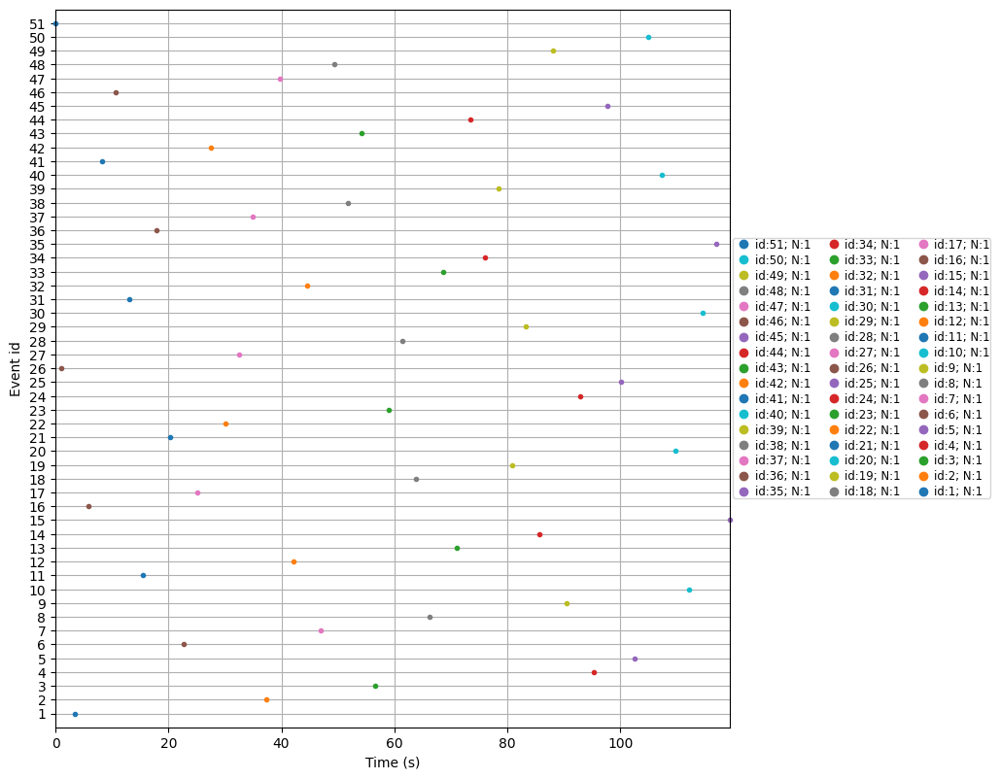

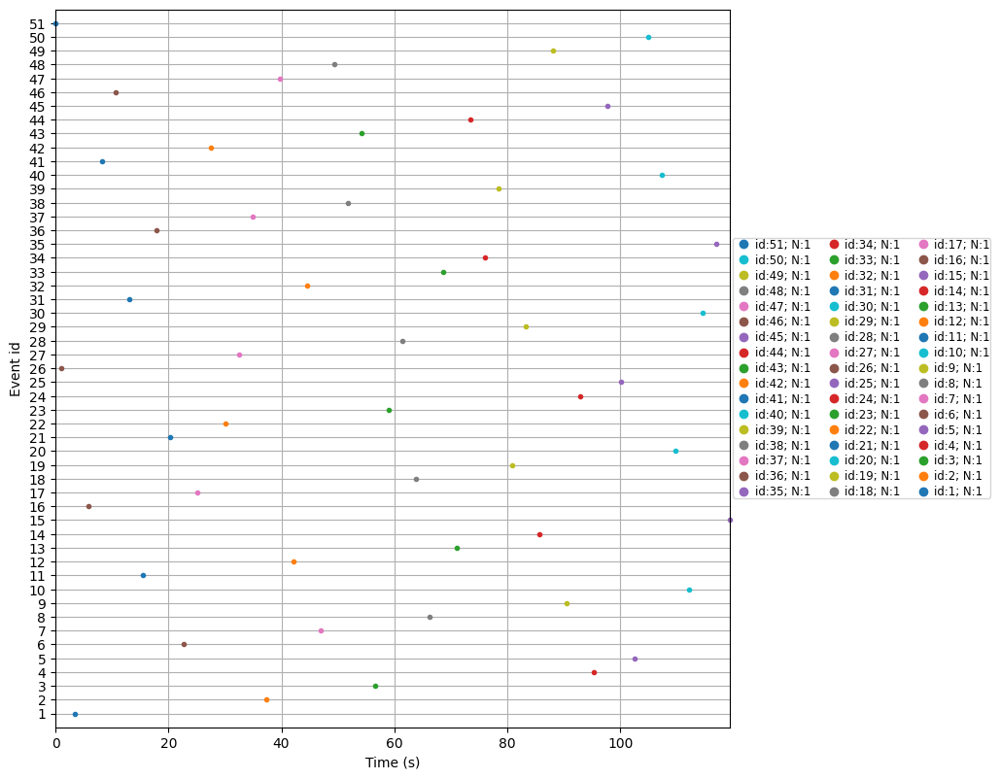

In [29]:
p_id = 'sub-01'
ses = 'ses-1'

# 檔案路徑
base_dir = r"/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc"
file_name = f"{ses}eeg_data01-filt-raw.fif"  # 根據實際檔名修改
file_path = os.path.join(base_dir, p_id, file_name)


# 讀取 .fif 檔（載入資料）
raw_filt = mne.io.read_raw_fif(file_path, preload=True)

# 從 annotations 擷取事件
events, events_dict = mne.events_from_annotations(raw_filt)

# 印出事件對應字典（可選）
print(events_dict)

# 畫出事件分佈圖（隨時間）
mne.viz.plot_events(events, sfreq=raw_filt.info['sfreq'], first_samp=raw_filt.first_samp)

##Segment the data into epochs

In [30]:
mne.Epochs(raw_filt, events, event_id=None, tmin=-0.2, tmax=0.5, baseline=(None, 0), picks=None, preload=False, reject=None, flat=None, proj=True, decim=1, reject_tmin=None, reject_tmax=None, detrend=None, on_missing='raise', reject_by_annotation=True, metadata=None, event_repeated='error', verbose=None)

<Epochs | 51 events (good & bad), -0.2 – 0.5 s (baseline -0.2 – 0 s), ~42 KiB, data not loaded,
 '1': 1
 '2': 1
 '3': 1
 '4': 1
 '5': 1
 '6': 1
 '7': 1
 '8': 1
 '9': 1
 '10': 1
 and 41 more events ...>

In [31]:
# Epoching settings
tmin =  -.100  # start of each epoch (in sec)
tmax =  2.000  # end of each epoch (in sec)
baseline = (None, 0)

# Create epochs
# Epoching settings
tmin =  -.100  # start of each epoch (in sec)
tmax =  2.000  # end of each epoch (in sec)
baseline = (None, 0)

# Create epochs
epochs = mne.Epochs(raw_filt,
                    events, event_id=None,
                    tmin=tmin, tmax=tmax)
# Epoching settings
tmin =  -.100  # start of each epoch (in sec)
tmax =  2.000  # end of each epoch (in sec)
baseline = (None, 0)

# Create epochs
epochs = mne.Epochs(raw_filt,
                    events, event_id=None,
                    tmin=tmin, tmax=tmax,
                    baseline=baseline,
                    preload=True
                   )
tmax =  2.000  # end of each epoch (in sec)
baseline = (None, 0)

# Create epochs
epochs = mne.Epochs(raw_filt,
                    events, event_id=None,
                    tmin=tmin, tmax=tmax,
                    baseline=baseline,
                    preload=True
                   )
epochs

<Epochs | 50 events (all good), -0.1 – 2 s (baseline -0.1 – 0 s), ~4.9 MiB, data loaded,
 '1': 1
 '2': 1
 '3': 1
 '4': 1
 '5': 1
 '6': 1
 '7': 1
 '8': 1
 '9': 1
 '10': 1
 and 41 more events ...>

##Visualize Average ERP Across Conditions of Interest – Before Artifact Correction

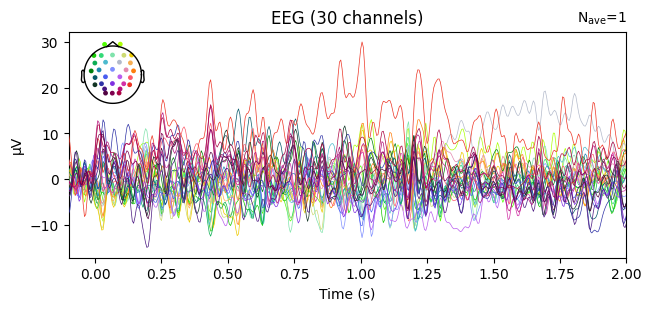

In [32]:
epochs['1'].average().plot(); # remember the semicolon prevents a duplicated plot

In [33]:
# read the previously-saved ICA decomposition
ica = mne.preprocessing.read_ica('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/' + p_id + '-ica.fif')

# apply the ICA decomposition (excluding the marked ICs) to the epochs
epochs_postica = ica.apply(epochs.copy())

TypeError: ylim must be an instance of dict or None, got <class 'list'> instead.

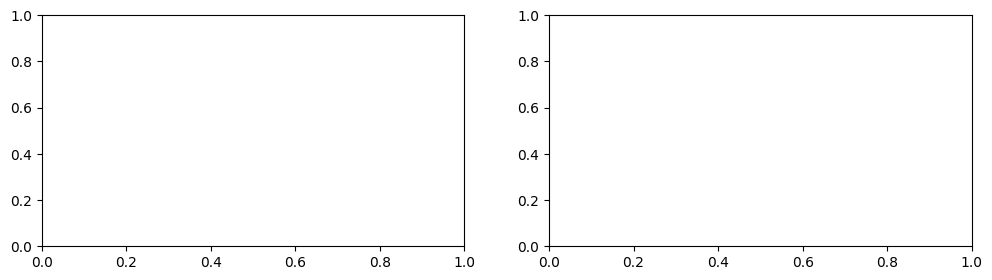

In [34]:
fig, ax = plt.subplots(1, 2, figsize=[12, 3])

epochs['1'].average().plot(axes=ax[0], ylim=[-11, 10], show=False); # remember the semicolon prevents a duplicated plot
epochs_postica['1'].average().plot(axes=ax[1], ylim=[-11, 10]);

In [35]:
from autoreject import AutoReject

ar = AutoReject(n_interpolate=[1, 2, 4],
                random_state=42,
                picks=mne.pick_types(epochs_postica.info,
                                     eeg=True,
                                     eog=False
                                    ),
                n_jobs=-1,
                verbose=False
                )

epochs_clean, reject_log_clean = ar.fit_transform(epochs_postica, return_log=True)

epochs_clean

<Epochs | 48 events (all good), -0.1 – 2 s (baseline -0.1 – 0 s), ~4.7 MiB, data loaded,
 '1': 1
 '2': 1
 '3': 1
 '4': 1
 '5': 1
 '6': 1
 '7': 1
 '8': 1
 '9': 1
 '10': 1
 and 41 more events ...>

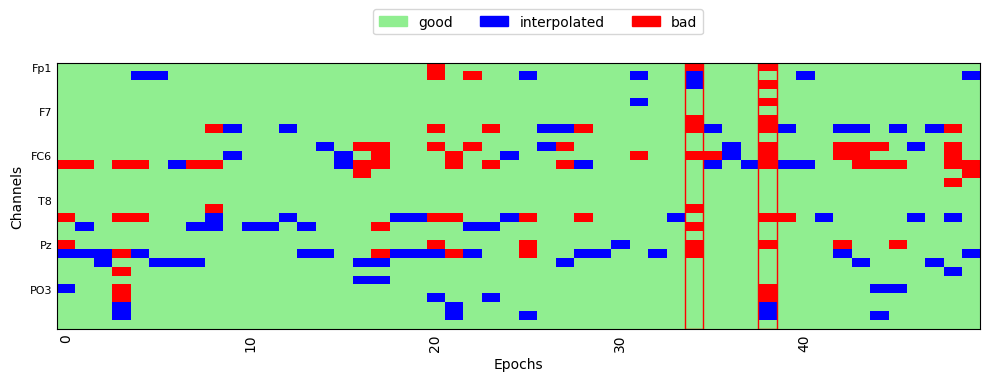

In [36]:
fig, ax = plt.subplots(figsize=[10, 4])
reject_log_clean.plot('horizontal', aspect='auto', ax=ax)
plt.show()

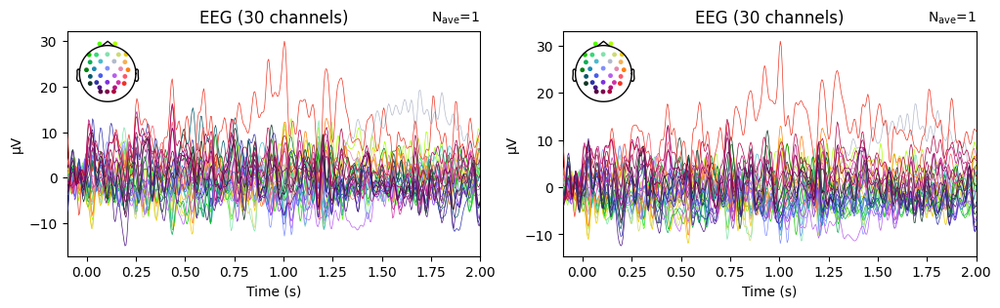

In [37]:
fig, ax = plt.subplots(1, 2, figsize=[12, 3])

epochs['1'].average().plot(axes=ax[0], show=False); # remember the semicolon prevents a duplicated plot
epochs_clean['1'].average().plot(axes=ax[1]);

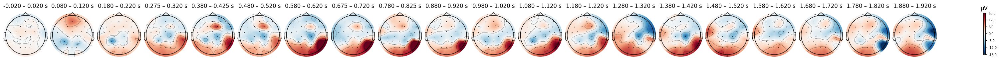

In [38]:
# Specify times to plot at, as [min],[max],[stepsize]
times = np.arange(0, tmax, 0.1)

epochs_clean['50'].average().plot_topomap(times=times, average=0.050);

In [39]:
#save epcjs
epochs_clean.save('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/' + p_id + '-epo.fif', overwrite=True)


[PosixPath('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/sub-01-epo.fif')]

# Averaging and Re-Referencing ERPs

In [40]:
import mne
mne.set_log_level('error')  # reduce extraneous MNE output

# Participant ID code
p_id = 'sub-01'
data_dir = 'data/' + p_id + '/'

epochs = mne.read_epochs('/content/drive/MyDrive/neuro something/TMNRED/derivatives/preproc/sub-01/' + p_id + '-epo.fif', preload=True).set_montage('easycap-M1')

##Evoked objects — Averaged ERPs

*  `Epochs`本身的定義就是包含多個trial，且每個trial都有一個對應的條件標籤(event code）
*  `Evoked` 資料則是針對單一條件中所有試次的平均結果。因此，我們需要為實驗中的每一個條件分別建立一個 Evoked 物件。
*  為了方便起見，我們可以把這些物件儲存到一個 list 中，並且使用 dictionary comprehension 的方式來建立這個 Evoked 物件的清單，使得字典中的每個 key 是條件名稱，而對應的 value 則是該條件下的 Evoked 物件。

In [41]:
conditions = ['1','2','3','4','5','6','7']

evokeds = {c:epochs[c].average() for c in conditions}

evokeds

{'1': <Evoked | '1' (average, N=1), -0.1 – 2 s, baseline -0.1 – 0 s, 30 ch, ~141 KiB>,
 '2': <Evoked | '2' (average, N=1), -0.1 – 2 s, baseline -0.1 – 0 s, 30 ch, ~141 KiB>,
 '3': <Evoked | '3' (average, N=1), -0.1 – 2 s, baseline -0.1 – 0 s, 30 ch, ~141 KiB>,
 '4': <Evoked | '4' (average, N=1), -0.1 – 2 s, baseline -0.1 – 0 s, 30 ch, ~141 KiB>,
 '5': <Evoked | '5' (average, N=1), -0.1 – 2 s, baseline -0.1 – 0 s, 30 ch, ~141 KiB>,
 '6': <Evoked | '6' (average, N=1), -0.1 – 2 s, baseline -0.1 – 0 s, 30 ch, ~141 KiB>,
 '7': <Evoked | '7' (average, N=1), -0.1 – 2 s, baseline -0.1 – 0 s, 30 ch, ~141 KiB>}

##Plot average ERP for each condition

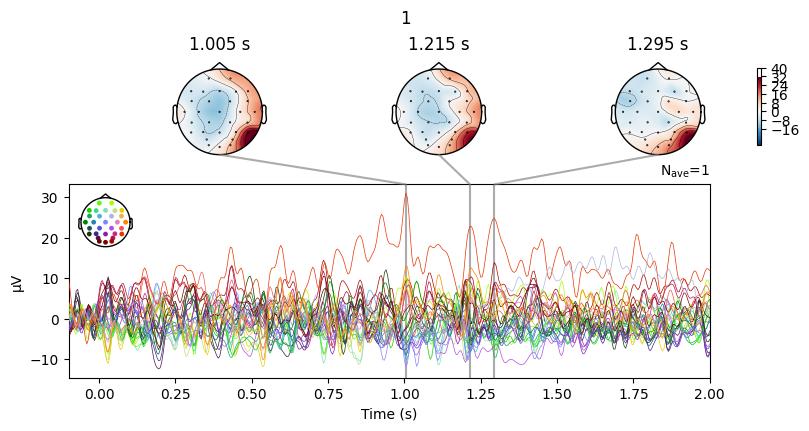

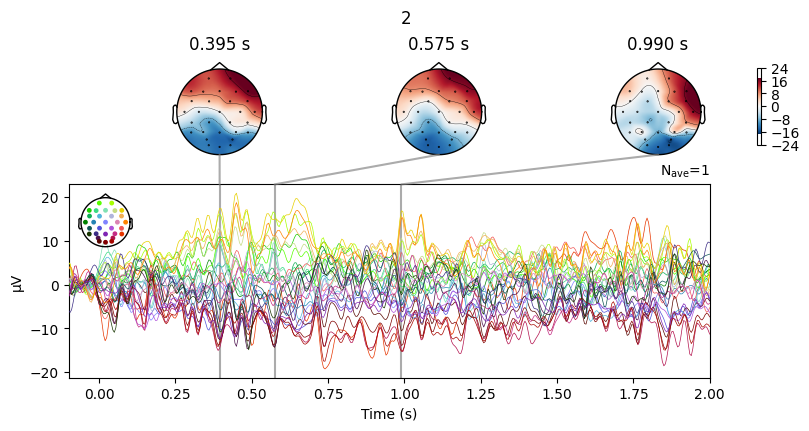

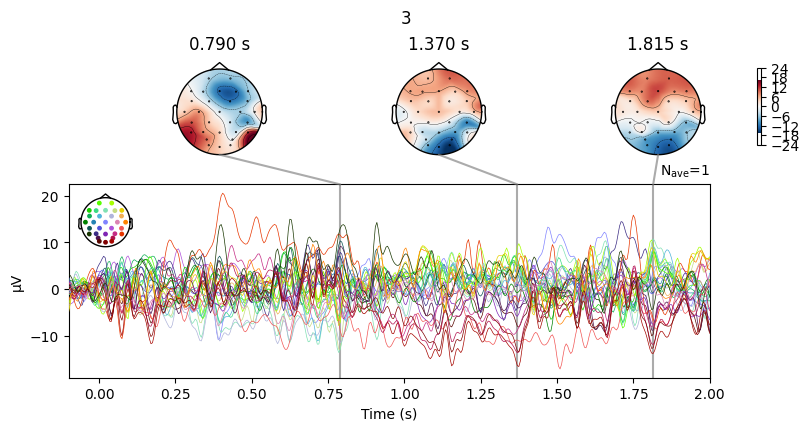

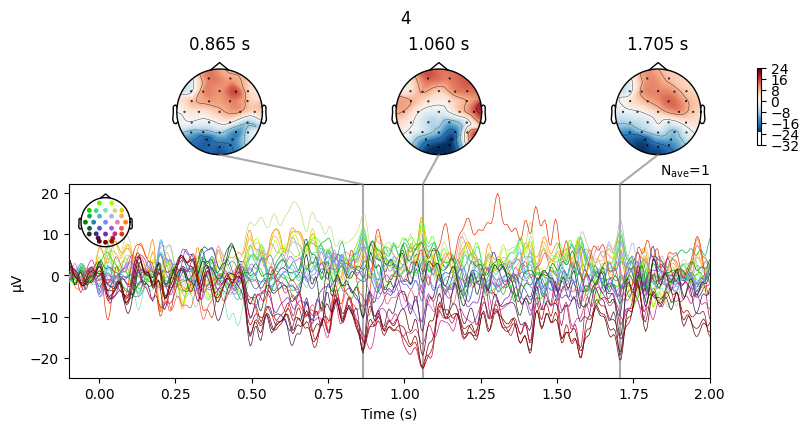

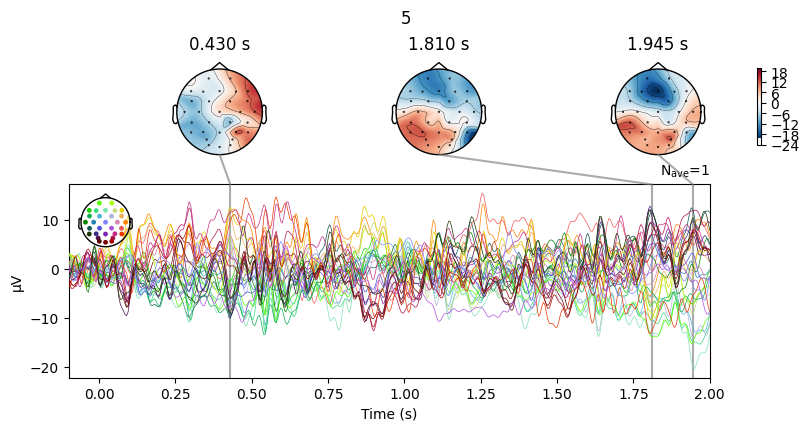

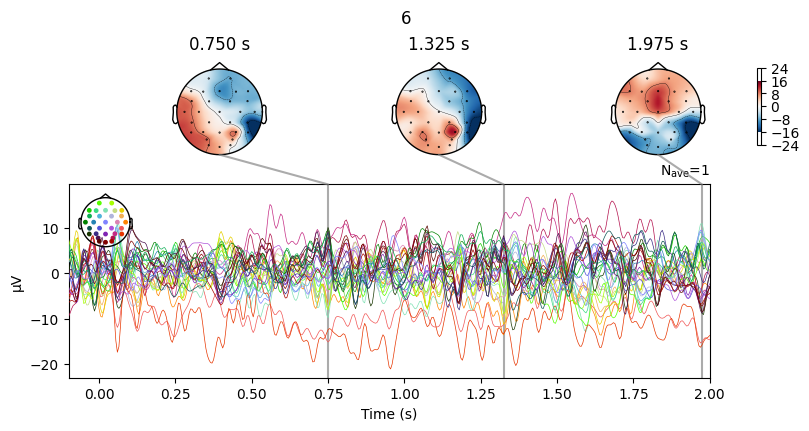

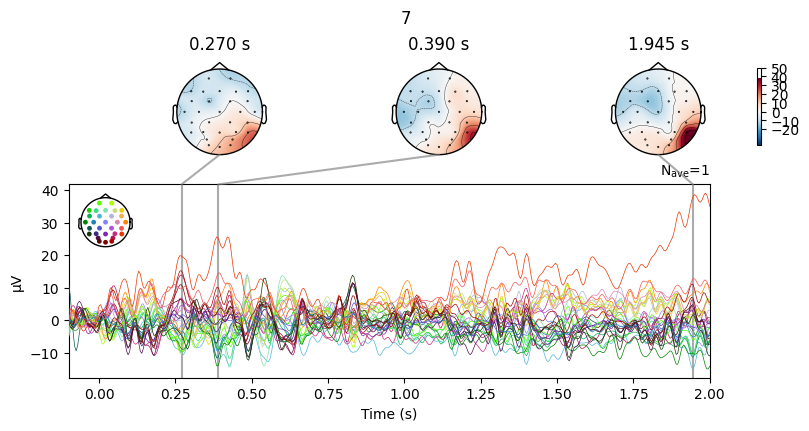

In [42]:
for c in evokeds.keys():
    evokeds[c].plot_joint(title=c);

##Examine contrasts between conditions

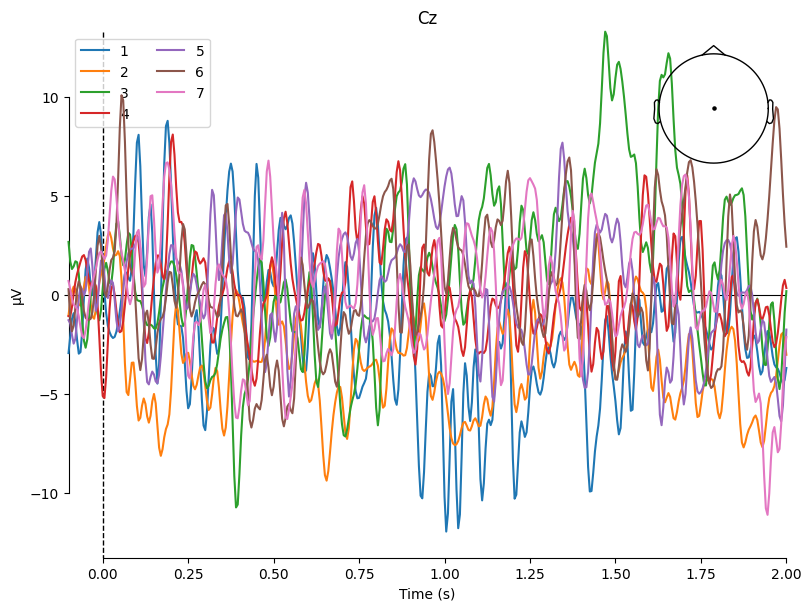

In [43]:
mne.viz.plot_compare_evokeds(evokeds, picks='Cz');

##View Waveform Plots at Midline Channels with Average Reference

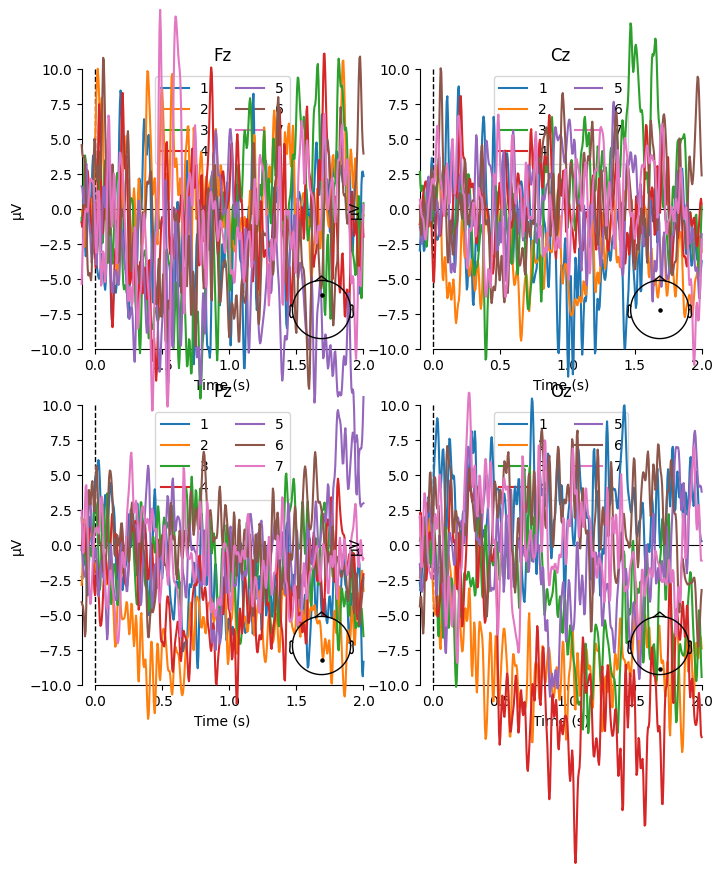

In [44]:
import matplotlib.pyplot as plt

# define the channels we want plots for
channels = ['Fz', 'Cz', 'Pz', 'Oz']

# create a figure with 4 subplots
fig, axes = plt.subplots(2, 2, figsize=(8, 8))

# plot each channel in a separate subplot
for idx, chan in enumerate(channels):
    mne.viz.plot_compare_evokeds(evokeds,
                                picks=chan,
                                ylim={'eeg':(-10, 10)},
                                show_sensors='lower right',
                                legend='upper center',
                                axes=axes.reshape(-1)[idx],
                                show=False
                                );
plt.show()

##View Topomaps with Average Reference

In [45]:
evokeds_avgref = {c:evokeds[c].copy().set_eeg_reference(ref_channels='average')
                  for c in evokeds.keys()
                  }

----------------------------------
1 (average reference)


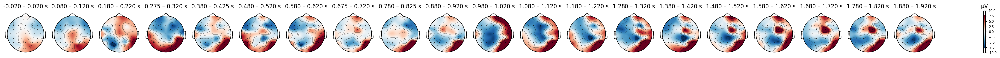

1 (original (FCz) reference)


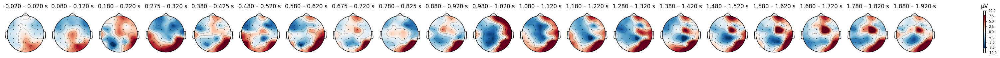

----------------------------------
2 (average reference)


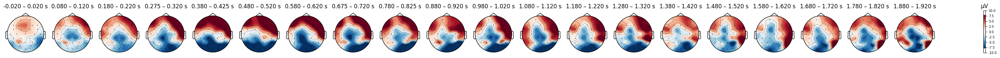

2 (original (FCz) reference)


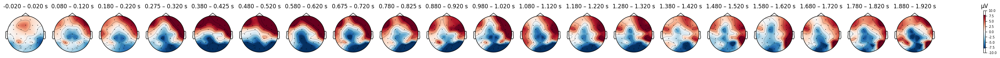

----------------------------------
3 (average reference)


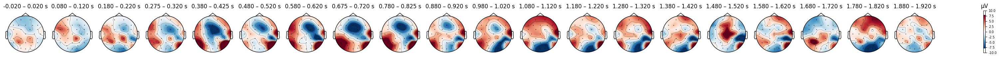

3 (original (FCz) reference)


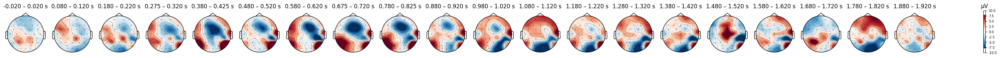

----------------------------------
4 (average reference)


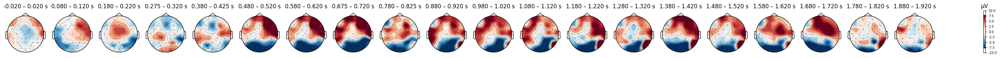

4 (original (FCz) reference)


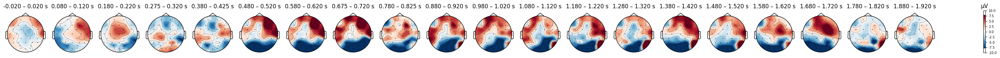

----------------------------------
5 (average reference)


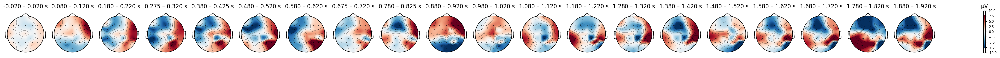

5 (original (FCz) reference)


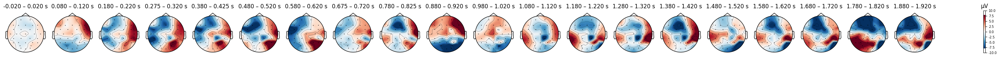

----------------------------------
6 (average reference)


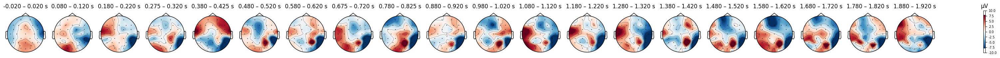

6 (original (FCz) reference)


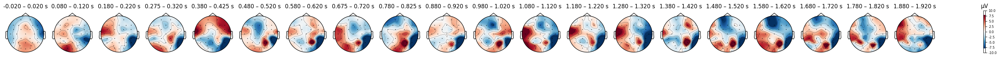

----------------------------------
7 (average reference)


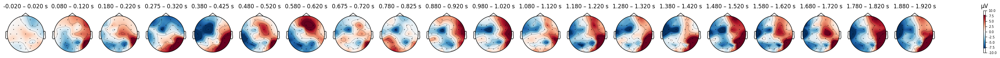

7 (original (FCz) reference)


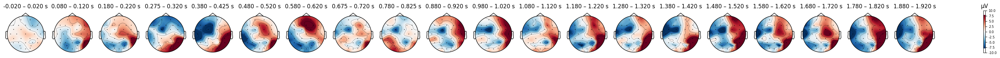

In [46]:
for condition in evokeds_avgref.keys():
    print('----------------------------------')
    print(condition + ' (average reference)')
    evokeds_avgref[condition].plot_topomap(times=times, average=0.050, vlim=(-8, 8));

    print(condition + ' (original (FCz) reference)')
    evokeds[condition].plot_topomap(times=times, average=0.050, vlim=(-8, 8));


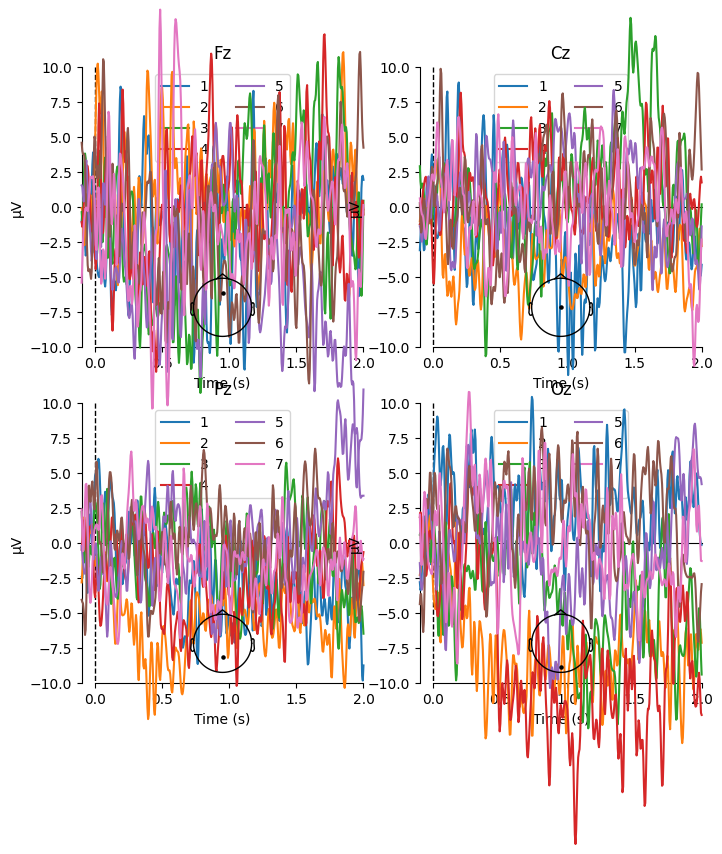

In [47]:
# create a figure with 4 subplots
fig, axes = plt.subplots(2, 2, figsize=(8, 8))

# plot each channel in a separate subplot
for idx, chan in enumerate(channels):
    mne.viz.plot_compare_evokeds(evokeds_avgref,
                                picks=chan,
                                ylim={'eeg':(-10, 10)},
                                show_sensors='lower center',
                                legend='upper center',
                                axes=axes.reshape(-1)[idx],
                                show=False
                                );
plt.show()

##Re-Reference the Data to Averaged Mastoids

In [48]:
evokeds_mastoidref = {c:evokeds[c].copy().set_eeg_reference(ref_channels=['Fp1', 'Fp2'])
                      for c in evokeds.keys()
                      }

----------------------------------
1 (mastoid reference)


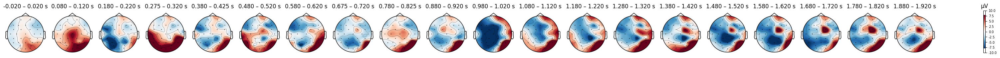

1 (average reference)


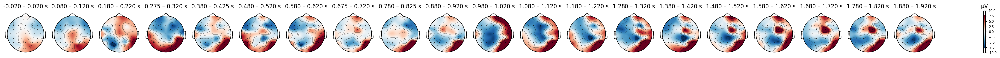

1 (original (FCz) reference)


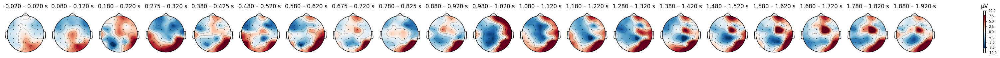

----------------------------------
2 (mastoid reference)


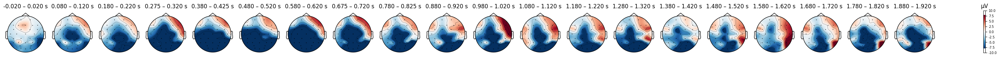

2 (average reference)


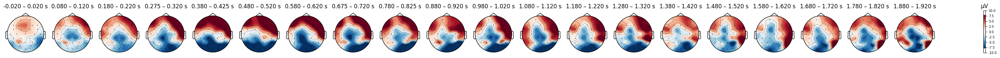

2 (original (FCz) reference)


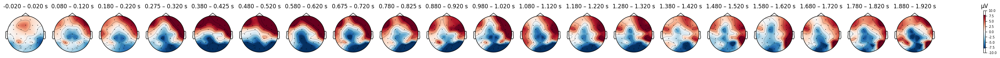

----------------------------------
3 (mastoid reference)


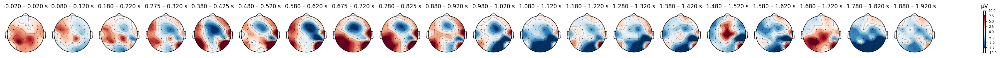

3 (average reference)


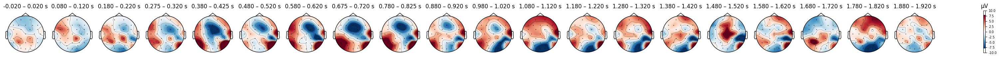

3 (original (FCz) reference)


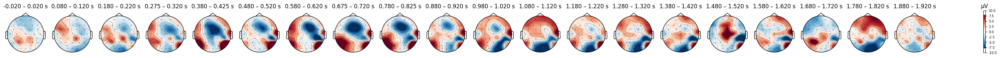

----------------------------------
4 (mastoid reference)


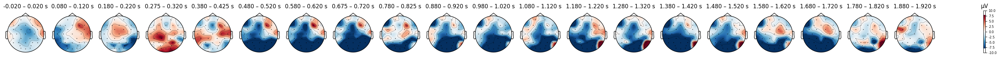

4 (average reference)


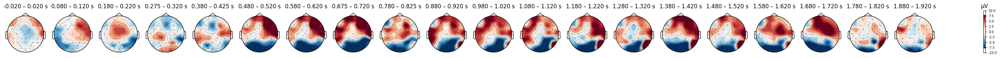

4 (original (FCz) reference)


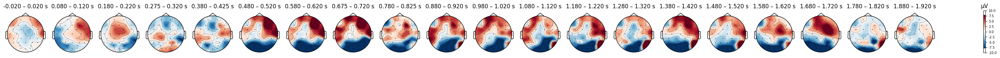

----------------------------------
5 (mastoid reference)


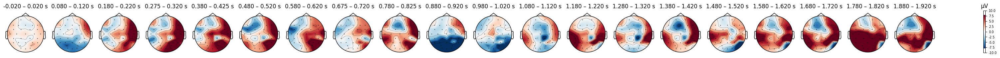

5 (average reference)


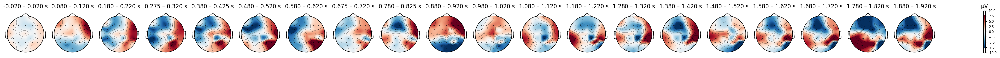

5 (original (FCz) reference)


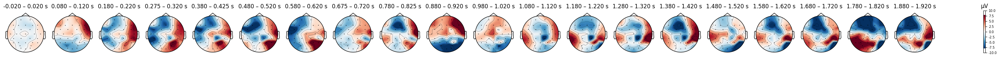

----------------------------------
6 (mastoid reference)


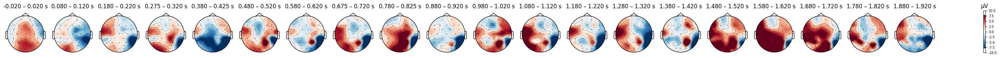

6 (average reference)


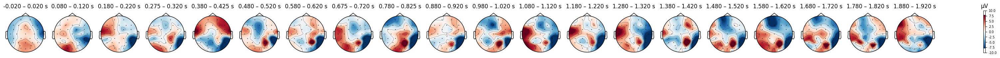

6 (original (FCz) reference)


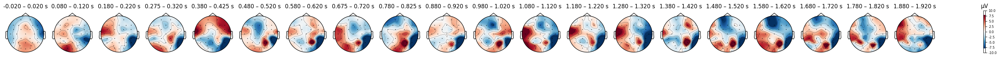

----------------------------------
7 (mastoid reference)


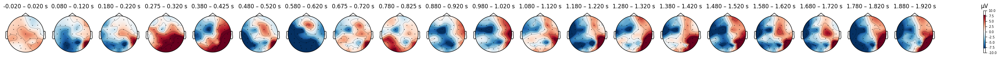

7 (average reference)


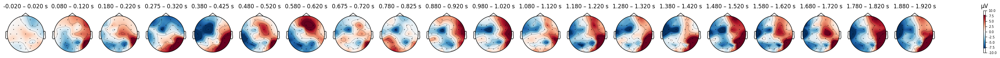

7 (original (FCz) reference)


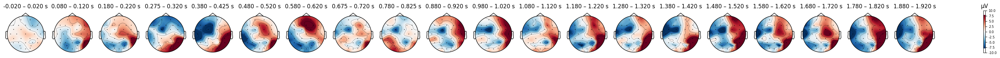

In [49]:
for condition in evokeds_mastoidref.keys():
    print('----------------------------------')
    print(condition + ' (mastoid reference)')
    evokeds_mastoidref[condition].plot_topomap(times=times, average=0.050, vlim=(-8, 8));

    print(condition + ' (average reference)')
    evokeds_avgref[condition].plot_topomap(times=times, average=0.050, vlim=(-8, 8));

    print(condition + ' (original (FCz) reference)')
    evokeds[condition].plot_topomap(times=times, average=0.050, vlim=(-8, 8));
